In [1]:
    import numpy as np
    import pandas as pd
    import sklearn
    import seaborn as sns
    import matplotlib.pyplot as plt
    from sklearn.linear_model import LinearRegression
    from sklearn.metrics import mean_squared_error,mean_absolute_error
    from sklearn.model_selection import train_test_split
    import warnings
    warnings.filterwarnings("ignore")

In [2]:
df=pd.read_csv("Temperature",sep=",")
df.head()

,station,Date,Present_Tmax,Present_Tmin,LDAPS_RHmin,LDAPS_RHmax,LDAPS_Tmax_lapse,LDAPS_Tmin_lapse,LDAPS_WS,LDAPS_LH,...,LDAPS_PPT2,LDAPS_PPT3,LDAPS_PPT4,lat,lon,DEM,Slope,Solar radiation,Next_Tmax,Next_Tmin
0,1.0,30-06-2013,28.7,21.4,58.255688,91.116364,28.074101,23.006936,6.818887,69.451805,...,0.0,0.0,0.0,37.6046,126.991,212.3350,2.7850,5992.895996,29.1,21.2
1,2.0,30-06-2013,31.9,21.6,52.263397,90.604721,29.850689,24.035009,5.691890,51.937448,...,0.0,0.0,0.0,37.6046,127.032,44.7624,0.5141,5869.312500,30.5,22.5
2,3.0,30-06-2013,31.6,23.3,48.690479,83.973587,30.091292,24.565633,6.138224,20.573050,...,0.0,0.0,0.0,37.5776,127.058,33.3068,0.2661,5863.555664,31.1,23.9
3,4.0,30-06-2013,32.0,23.4,58.239788,96.483688,29.704629,23.326177,5.650050,65.727144,...,0.0,0.0,0.0,37.6450,127.022,45.7160,2.5348,5856.964844,31.7,24.3
4,5.0,30-06-2013,31.4,21.9,56.174095,90.155128,29.113934,23.486480,5.735004,107.965535,...,0.0,0.0,0.0,37.5507,127.135,35.0380,0.5055,5859.552246,31.2,22.5


Above details shows the  dataset being imported

In [3]:
df=pd.DataFrame(data=df)

In [4]:
df.shape

(7752, 25)

We have 7752 rows and 25 columns

In [5]:
df.dtypes

station             float64
Date                 object
Present_Tmax        float64
Present_Tmin        float64
LDAPS_RHmin         float64
LDAPS_RHmax         float64
LDAPS_Tmax_lapse    float64
LDAPS_Tmin_lapse    float64
LDAPS_WS            float64
LDAPS_LH            float64
LDAPS_CC1           float64
LDAPS_CC2           float64
LDAPS_CC3           float64
LDAPS_CC4           float64
LDAPS_PPT1          float64
LDAPS_PPT2          float64
LDAPS_PPT3          float64
LDAPS_PPT4          float64
lat                 float64
lon                 float64
DEM                 float64
Slope               float64
Solar radiation     float64
Next_Tmax           float64
Next_Tmin           float64
dtype: object

We have both object and float type values in all columns

<AxesSubplot:>

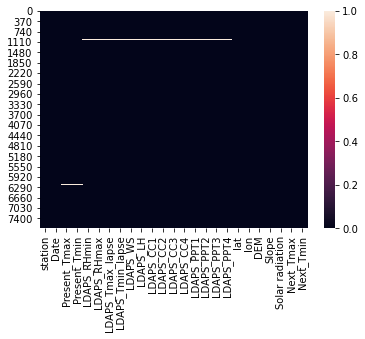

In [6]:
sns.heatmap(df.isnull())

The above heat map shows there are  null values

In [7]:
df.describe()

,station,Present_Tmax,Present_Tmin,LDAPS_RHmin,LDAPS_RHmax,LDAPS_Tmax_lapse,LDAPS_Tmin_lapse,LDAPS_WS,LDAPS_LH,LDAPS_CC1,...,LDAPS_PPT2,LDAPS_PPT3,LDAPS_PPT4,lat,lon,DEM,Slope,Solar radiation,Next_Tmax,Next_Tmin
count,7750.000000,7682.000000,7682.000000,7677.000000,7677.000000,7677.000000,7677.000000,7677.000000,7677.000000,7677.000000,...,7677.000000,7677.000000,7677.000000,7752.000000,7752.000000,7752.000000,7752.000000,7752.000000,7725.000000,7725.000000
mean,13.000000,29.768211,23.225059,56.759372,88.374804,29.613447,23.512589,7.097875,62.505019,0.368774,...,0.485003,0.278200,0.269407,37.544722,126.991397,61.867972,1.257048,5341.502803,30.274887,22.932220
std,7.211568,2.969999,2.413961,14.668111,7.192004,2.947191,2.345347,2.183836,33.730589,0.262458,...,1.762807,1.161809,1.206214,0.050352,0.079435,54.279780,1.370444,429.158867,3.128010,2.487613
min,1.000000,20.000000,11.300000,19.794666,58.936283,17.624954,14.272646,2.882580,-13.603212,0.000000,...,0.000000,0.000000,0.000000,37.456200,126.826000,12.370000,0.098475,4329.520508,17.400000,11.300000
25%,7.000000,27.800000,21.700000,45.963543,84.222862,27.673499,22.089739,5.678705,37.266753,0.146654,...,0.000000,0.000000,0.000000,37.510200,126.937000,28.700000,0.271300,4999.018555,28.200000,21.300000
50%,13.000000,29.900000,23.400000,55.039024,89.793480,29.703426,23.760199,6.547470,56.865482,0.315697,...,0.000000,0.000000,0.000000,37.550700,126.995000,45.716000,0.618000,5436.345215,30.500000,23.100000
75%,19.000000,32.000000,24.900000,67.190056,93.743629,31.710450,25.152909,8.032276,84.223616,0.575489,...,0.018364,0.007896,0.000041,37.577600,127.042000,59.832400,1.767800,5728.316406,32.600000,24.600000
max,25.000000,37.600000,29.900000,98.524734,100.000153,38.542255,29.619342,21.857621,213.414006,0.967277,...,21.621661,15.841235,16.655469,37.645000,127.135000,212.335000,5.178230,5992.895996,38.900000,29.800000


The above data shows standard devation,Mean,Count,25%percentile,50%percentile,75%percentile,minimum value and maximum value

In [8]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7752 entries, 0 to 7751
Data columns (total 25 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   station           7750 non-null   float64
 1   Date              7750 non-null   object 
 2   Present_Tmax      7682 non-null   float64
 3   Present_Tmin      7682 non-null   float64
 4   LDAPS_RHmin       7677 non-null   float64
 5   LDAPS_RHmax       7677 non-null   float64
 6   LDAPS_Tmax_lapse  7677 non-null   float64
 7   LDAPS_Tmin_lapse  7677 non-null   float64
 8   LDAPS_WS          7677 non-null   float64
 9   LDAPS_LH          7677 non-null   float64
 10  LDAPS_CC1         7677 non-null   float64
 11  LDAPS_CC2         7677 non-null   float64
 12  LDAPS_CC3         7677 non-null   float64
 13  LDAPS_CC4         7677 non-null   float64
 14  LDAPS_PPT1        7677 non-null   float64
 15  LDAPS_PPT2        7677 non-null   float64
 16  LDAPS_PPT3        7677 non-null   float64


Shows number of rows,null values and datatypes

In [9]:
df.isnull().sum()

station              2
Date                 2
Present_Tmax        70
Present_Tmin        70
LDAPS_RHmin         75
LDAPS_RHmax         75
LDAPS_Tmax_lapse    75
LDAPS_Tmin_lapse    75
LDAPS_WS            75
LDAPS_LH            75
LDAPS_CC1           75
LDAPS_CC2           75
LDAPS_CC3           75
LDAPS_CC4           75
LDAPS_PPT1          75
LDAPS_PPT2          75
LDAPS_PPT3          75
LDAPS_PPT4          75
lat                  0
lon                  0
DEM                  0
Slope                0
Solar radiation      0
Next_Tmax           27
Next_Tmin           27
dtype: int64

As we can see there are  null values in few columns

In [10]:
pd.set_option("display.max_columns",None)

The above code is used to show the whole details

In [11]:
df.head()

,station,Date,Present_Tmax,Present_Tmin,LDAPS_RHmin,LDAPS_RHmax,LDAPS_Tmax_lapse,LDAPS_Tmin_lapse,LDAPS_WS,LDAPS_LH,LDAPS_CC1,LDAPS_CC2,LDAPS_CC3,LDAPS_CC4,LDAPS_PPT1,LDAPS_PPT2,LDAPS_PPT3,LDAPS_PPT4,lat,lon,DEM,Slope,Solar radiation,Next_Tmax,Next_Tmin
0,1.0,30-06-2013,28.7,21.4,58.255688,91.116364,28.074101,23.006936,6.818887,69.451805,0.233947,0.203896,0.161697,0.130928,0.0,0.0,0.0,0.0,37.6046,126.991,212.3350,2.7850,5992.895996,29.1,21.2
1,2.0,30-06-2013,31.9,21.6,52.263397,90.604721,29.850689,24.035009,5.691890,51.937448,0.225508,0.251771,0.159444,0.127727,0.0,0.0,0.0,0.0,37.6046,127.032,44.7624,0.5141,5869.312500,30.5,22.5
2,3.0,30-06-2013,31.6,23.3,48.690479,83.973587,30.091292,24.565633,6.138224,20.573050,0.209344,0.257469,0.204091,0.142125,0.0,0.0,0.0,0.0,37.5776,127.058,33.3068,0.2661,5863.555664,31.1,23.9
3,4.0,30-06-2013,32.0,23.4,58.239788,96.483688,29.704629,23.326177,5.650050,65.727144,0.216372,0.226002,0.161157,0.134249,0.0,0.0,0.0,0.0,37.6450,127.022,45.7160,2.5348,5856.964844,31.7,24.3
4,5.0,30-06-2013,31.4,21.9,56.174095,90.155128,29.113934,23.486480,5.735004,107.965535,0.151407,0.249995,0.178892,0.170021,0.0,0.0,0.0,0.0,37.5507,127.135,35.0380,0.5055,5859.552246,31.2,22.5


In [12]:
df["Date"].head()

0    30-06-2013
1    30-06-2013
2    30-06-2013
3    30-06-2013
4    30-06-2013
Name: Date, dtype: object

In [13]:
from datetime import datetime

In [14]:
df['year'] = pd.DatetimeIndex(df['Date']).year
df.head()

,station,Date,Present_Tmax,Present_Tmin,LDAPS_RHmin,LDAPS_RHmax,LDAPS_Tmax_lapse,LDAPS_Tmin_lapse,LDAPS_WS,LDAPS_LH,LDAPS_CC1,LDAPS_CC2,LDAPS_CC3,LDAPS_CC4,LDAPS_PPT1,LDAPS_PPT2,LDAPS_PPT3,LDAPS_PPT4,lat,lon,DEM,Slope,Solar radiation,Next_Tmax,Next_Tmin,year
0,1.0,30-06-2013,28.7,21.4,58.255688,91.116364,28.074101,23.006936,6.818887,69.451805,0.233947,0.203896,0.161697,0.130928,0.0,0.0,0.0,0.0,37.6046,126.991,212.3350,2.7850,5992.895996,29.1,21.2,2013.0
1,2.0,30-06-2013,31.9,21.6,52.263397,90.604721,29.850689,24.035009,5.691890,51.937448,0.225508,0.251771,0.159444,0.127727,0.0,0.0,0.0,0.0,37.6046,127.032,44.7624,0.5141,5869.312500,30.5,22.5,2013.0
2,3.0,30-06-2013,31.6,23.3,48.690479,83.973587,30.091292,24.565633,6.138224,20.573050,0.209344,0.257469,0.204091,0.142125,0.0,0.0,0.0,0.0,37.5776,127.058,33.3068,0.2661,5863.555664,31.1,23.9,2013.0
3,4.0,30-06-2013,32.0,23.4,58.239788,96.483688,29.704629,23.326177,5.650050,65.727144,0.216372,0.226002,0.161157,0.134249,0.0,0.0,0.0,0.0,37.6450,127.022,45.7160,2.5348,5856.964844,31.7,24.3,2013.0
4,5.0,30-06-2013,31.4,21.9,56.174095,90.155128,29.113934,23.486480,5.735004,107.965535,0.151407,0.249995,0.178892,0.170021,0.0,0.0,0.0,0.0,37.5507,127.135,35.0380,0.5055,5859.552246,31.2,22.5,2013.0


In [15]:
df['month'] = pd.DatetimeIndex(df['Date']).month
df.head()

,station,Date,Present_Tmax,Present_Tmin,LDAPS_RHmin,LDAPS_RHmax,LDAPS_Tmax_lapse,LDAPS_Tmin_lapse,LDAPS_WS,LDAPS_LH,LDAPS_CC1,LDAPS_CC2,LDAPS_CC3,LDAPS_CC4,LDAPS_PPT1,LDAPS_PPT2,LDAPS_PPT3,LDAPS_PPT4,lat,lon,DEM,Slope,Solar radiation,Next_Tmax,Next_Tmin,year,month
0,1.0,30-06-2013,28.7,21.4,58.255688,91.116364,28.074101,23.006936,6.818887,69.451805,0.233947,0.203896,0.161697,0.130928,0.0,0.0,0.0,0.0,37.6046,126.991,212.3350,2.7850,5992.895996,29.1,21.2,2013.0,6.0
1,2.0,30-06-2013,31.9,21.6,52.263397,90.604721,29.850689,24.035009,5.691890,51.937448,0.225508,0.251771,0.159444,0.127727,0.0,0.0,0.0,0.0,37.6046,127.032,44.7624,0.5141,5869.312500,30.5,22.5,2013.0,6.0
2,3.0,30-06-2013,31.6,23.3,48.690479,83.973587,30.091292,24.565633,6.138224,20.573050,0.209344,0.257469,0.204091,0.142125,0.0,0.0,0.0,0.0,37.5776,127.058,33.3068,0.2661,5863.555664,31.1,23.9,2013.0,6.0
3,4.0,30-06-2013,32.0,23.4,58.239788,96.483688,29.704629,23.326177,5.650050,65.727144,0.216372,0.226002,0.161157,0.134249,0.0,0.0,0.0,0.0,37.6450,127.022,45.7160,2.5348,5856.964844,31.7,24.3,2013.0,6.0
4,5.0,30-06-2013,31.4,21.9,56.174095,90.155128,29.113934,23.486480,5.735004,107.965535,0.151407,0.249995,0.178892,0.170021,0.0,0.0,0.0,0.0,37.5507,127.135,35.0380,0.5055,5859.552246,31.2,22.5,2013.0,6.0


In [16]:
df['day'] = pd.DatetimeIndex(df['Date']).day
df.head()

,station,Date,Present_Tmax,Present_Tmin,LDAPS_RHmin,LDAPS_RHmax,LDAPS_Tmax_lapse,LDAPS_Tmin_lapse,LDAPS_WS,LDAPS_LH,LDAPS_CC1,LDAPS_CC2,LDAPS_CC3,LDAPS_CC4,LDAPS_PPT1,LDAPS_PPT2,LDAPS_PPT3,LDAPS_PPT4,lat,lon,DEM,Slope,Solar radiation,Next_Tmax,Next_Tmin,year,month,day
0,1.0,30-06-2013,28.7,21.4,58.255688,91.116364,28.074101,23.006936,6.818887,69.451805,0.233947,0.203896,0.161697,0.130928,0.0,0.0,0.0,0.0,37.6046,126.991,212.3350,2.7850,5992.895996,29.1,21.2,2013.0,6.0,30.0
1,2.0,30-06-2013,31.9,21.6,52.263397,90.604721,29.850689,24.035009,5.691890,51.937448,0.225508,0.251771,0.159444,0.127727,0.0,0.0,0.0,0.0,37.6046,127.032,44.7624,0.5141,5869.312500,30.5,22.5,2013.0,6.0,30.0
2,3.0,30-06-2013,31.6,23.3,48.690479,83.973587,30.091292,24.565633,6.138224,20.573050,0.209344,0.257469,0.204091,0.142125,0.0,0.0,0.0,0.0,37.5776,127.058,33.3068,0.2661,5863.555664,31.1,23.9,2013.0,6.0,30.0
3,4.0,30-06-2013,32.0,23.4,58.239788,96.483688,29.704629,23.326177,5.650050,65.727144,0.216372,0.226002,0.161157,0.134249,0.0,0.0,0.0,0.0,37.6450,127.022,45.7160,2.5348,5856.964844,31.7,24.3,2013.0,6.0,30.0
4,5.0,30-06-2013,31.4,21.9,56.174095,90.155128,29.113934,23.486480,5.735004,107.965535,0.151407,0.249995,0.178892,0.170021,0.0,0.0,0.0,0.0,37.5507,127.135,35.0380,0.5055,5859.552246,31.2,22.5,2013.0,6.0,30.0


We are spliting date columns into different seperate column

In [17]:
df.head()

,station,Date,Present_Tmax,Present_Tmin,LDAPS_RHmin,LDAPS_RHmax,LDAPS_Tmax_lapse,LDAPS_Tmin_lapse,LDAPS_WS,LDAPS_LH,LDAPS_CC1,LDAPS_CC2,LDAPS_CC3,LDAPS_CC4,LDAPS_PPT1,LDAPS_PPT2,LDAPS_PPT3,LDAPS_PPT4,lat,lon,DEM,Slope,Solar radiation,Next_Tmax,Next_Tmin,year,month,day
0,1.0,30-06-2013,28.7,21.4,58.255688,91.116364,28.074101,23.006936,6.818887,69.451805,0.233947,0.203896,0.161697,0.130928,0.0,0.0,0.0,0.0,37.6046,126.991,212.3350,2.7850,5992.895996,29.1,21.2,2013.0,6.0,30.0
1,2.0,30-06-2013,31.9,21.6,52.263397,90.604721,29.850689,24.035009,5.691890,51.937448,0.225508,0.251771,0.159444,0.127727,0.0,0.0,0.0,0.0,37.6046,127.032,44.7624,0.5141,5869.312500,30.5,22.5,2013.0,6.0,30.0
2,3.0,30-06-2013,31.6,23.3,48.690479,83.973587,30.091292,24.565633,6.138224,20.573050,0.209344,0.257469,0.204091,0.142125,0.0,0.0,0.0,0.0,37.5776,127.058,33.3068,0.2661,5863.555664,31.1,23.9,2013.0,6.0,30.0
3,4.0,30-06-2013,32.0,23.4,58.239788,96.483688,29.704629,23.326177,5.650050,65.727144,0.216372,0.226002,0.161157,0.134249,0.0,0.0,0.0,0.0,37.6450,127.022,45.7160,2.5348,5856.964844,31.7,24.3,2013.0,6.0,30.0
4,5.0,30-06-2013,31.4,21.9,56.174095,90.155128,29.113934,23.486480,5.735004,107.965535,0.151407,0.249995,0.178892,0.170021,0.0,0.0,0.0,0.0,37.5507,127.135,35.0380,0.5055,5859.552246,31.2,22.5,2013.0,6.0,30.0


In [18]:
df.drop("Date",axis="columns",inplace=True)

In [19]:
df.head()

,station,Present_Tmax,Present_Tmin,LDAPS_RHmin,LDAPS_RHmax,LDAPS_Tmax_lapse,LDAPS_Tmin_lapse,LDAPS_WS,LDAPS_LH,LDAPS_CC1,LDAPS_CC2,LDAPS_CC3,LDAPS_CC4,LDAPS_PPT1,LDAPS_PPT2,LDAPS_PPT3,LDAPS_PPT4,lat,lon,DEM,Slope,Solar radiation,Next_Tmax,Next_Tmin,year,month,day
0,1.0,28.7,21.4,58.255688,91.116364,28.074101,23.006936,6.818887,69.451805,0.233947,0.203896,0.161697,0.130928,0.0,0.0,0.0,0.0,37.6046,126.991,212.3350,2.7850,5992.895996,29.1,21.2,2013.0,6.0,30.0
1,2.0,31.9,21.6,52.263397,90.604721,29.850689,24.035009,5.691890,51.937448,0.225508,0.251771,0.159444,0.127727,0.0,0.0,0.0,0.0,37.6046,127.032,44.7624,0.5141,5869.312500,30.5,22.5,2013.0,6.0,30.0
2,3.0,31.6,23.3,48.690479,83.973587,30.091292,24.565633,6.138224,20.573050,0.209344,0.257469,0.204091,0.142125,0.0,0.0,0.0,0.0,37.5776,127.058,33.3068,0.2661,5863.555664,31.1,23.9,2013.0,6.0,30.0
3,4.0,32.0,23.4,58.239788,96.483688,29.704629,23.326177,5.650050,65.727144,0.216372,0.226002,0.161157,0.134249,0.0,0.0,0.0,0.0,37.6450,127.022,45.7160,2.5348,5856.964844,31.7,24.3,2013.0,6.0,30.0
4,5.0,31.4,21.9,56.174095,90.155128,29.113934,23.486480,5.735004,107.965535,0.151407,0.249995,0.178892,0.170021,0.0,0.0,0.0,0.0,37.5507,127.135,35.0380,0.5055,5859.552246,31.2,22.5,2013.0,6.0,30.0


<AxesSubplot:>

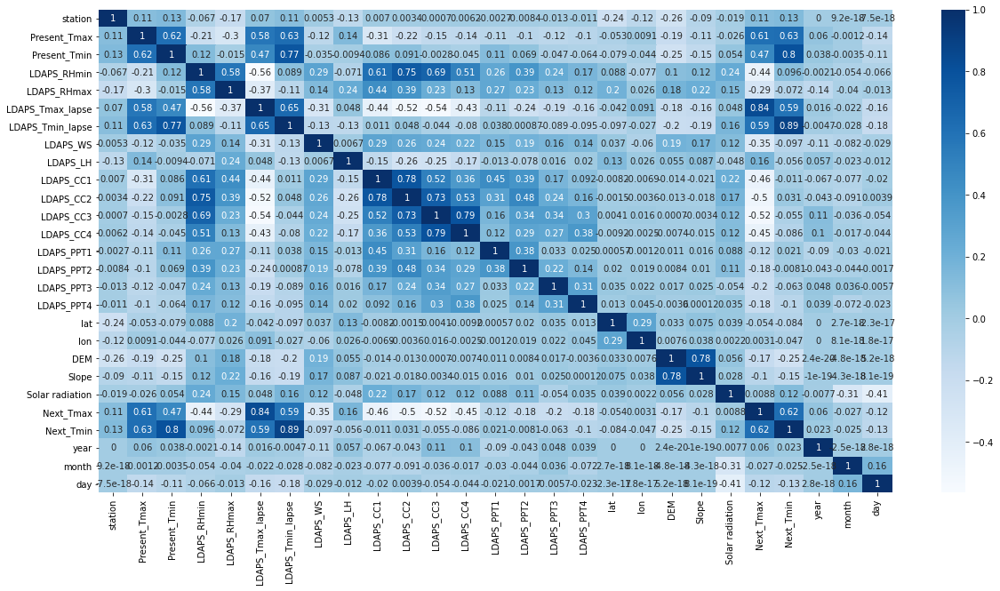

In [20]:
fig=plt.figure(figsize=(20,10))
hc=df.corr(method="pearson")
sns.heatmap(hc,annot=True,cmap="Blues")

    This shows corelation values in a heatmap. As we can see independent variables are both positively and negatively corelated with Target variable

In [21]:
df=df.replace(np.NaN,df.mean())

We have replaced NaN values with mean in all columns

In [22]:
df.isnull().sum()

station             0
Present_Tmax        0
Present_Tmin        0
LDAPS_RHmin         0
LDAPS_RHmax         0
LDAPS_Tmax_lapse    0
LDAPS_Tmin_lapse    0
LDAPS_WS            0
LDAPS_LH            0
LDAPS_CC1           0
LDAPS_CC2           0
LDAPS_CC3           0
LDAPS_CC4           0
LDAPS_PPT1          0
LDAPS_PPT2          0
LDAPS_PPT3          0
LDAPS_PPT4          0
lat                 0
lon                 0
DEM                 0
Slope               0
Solar radiation     0
Next_Tmax           0
Next_Tmin           0
year                0
month               0
day                 0
dtype: int64

As we can see there are no null values in any columns

In [23]:
df.head()

,station,Present_Tmax,Present_Tmin,LDAPS_RHmin,LDAPS_RHmax,LDAPS_Tmax_lapse,LDAPS_Tmin_lapse,LDAPS_WS,LDAPS_LH,LDAPS_CC1,LDAPS_CC2,LDAPS_CC3,LDAPS_CC4,LDAPS_PPT1,LDAPS_PPT2,LDAPS_PPT3,LDAPS_PPT4,lat,lon,DEM,Slope,Solar radiation,Next_Tmax,Next_Tmin,year,month,day
0,1.0,28.7,21.4,58.255688,91.116364,28.074101,23.006936,6.818887,69.451805,0.233947,0.203896,0.161697,0.130928,0.0,0.0,0.0,0.0,37.6046,126.991,212.3350,2.7850,5992.895996,29.1,21.2,2013.0,6.0,30.0
1,2.0,31.9,21.6,52.263397,90.604721,29.850689,24.035009,5.691890,51.937448,0.225508,0.251771,0.159444,0.127727,0.0,0.0,0.0,0.0,37.6046,127.032,44.7624,0.5141,5869.312500,30.5,22.5,2013.0,6.0,30.0
2,3.0,31.6,23.3,48.690479,83.973587,30.091292,24.565633,6.138224,20.573050,0.209344,0.257469,0.204091,0.142125,0.0,0.0,0.0,0.0,37.5776,127.058,33.3068,0.2661,5863.555664,31.1,23.9,2013.0,6.0,30.0
3,4.0,32.0,23.4,58.239788,96.483688,29.704629,23.326177,5.650050,65.727144,0.216372,0.226002,0.161157,0.134249,0.0,0.0,0.0,0.0,37.6450,127.022,45.7160,2.5348,5856.964844,31.7,24.3,2013.0,6.0,30.0
4,5.0,31.4,21.9,56.174095,90.155128,29.113934,23.486480,5.735004,107.965535,0.151407,0.249995,0.178892,0.170021,0.0,0.0,0.0,0.0,37.5507,127.135,35.0380,0.5055,5859.552246,31.2,22.5,2013.0,6.0,30.0


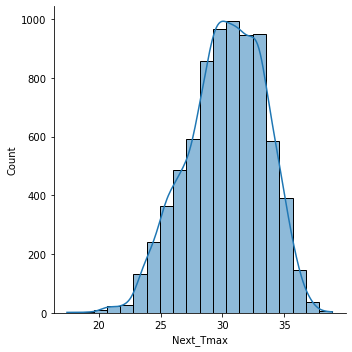

In [24]:
sns.displot(df["Next_Tmax"],bins=20,kde=True)

The above distribution plot for Next_Tmax

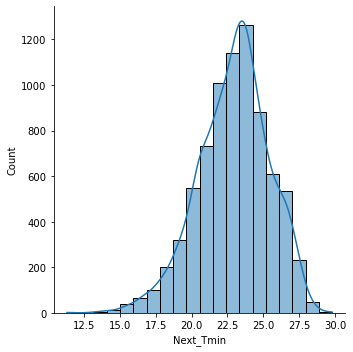

In [25]:
sns.displot(df["Next_Tmin"],bins=20,kde=True)

The above distribution plot for Next_Tmin

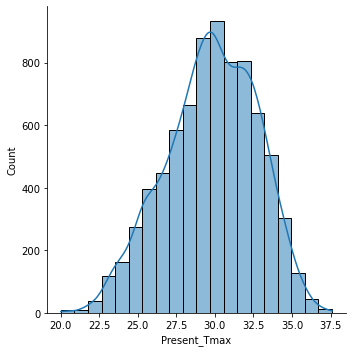

In [26]:
sns.displot(df["Present_Tmax"],bins=20,kde=True)

The above distribution plot for Present_Tmax

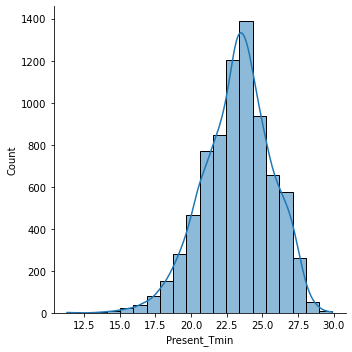

In [27]:
sns.displot(df["Present_Tmin"],bins=20,kde=True)

The above distribution plot for Present_Tmin

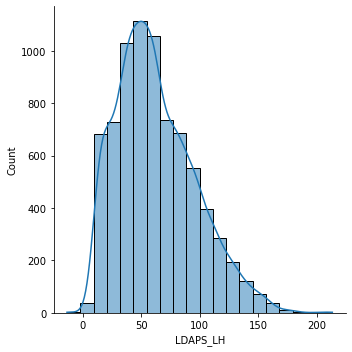

In [28]:
sns.displot(df["LDAPS_LH"],bins=20,kde=True)

The above distribution plot for LDAPS_LH

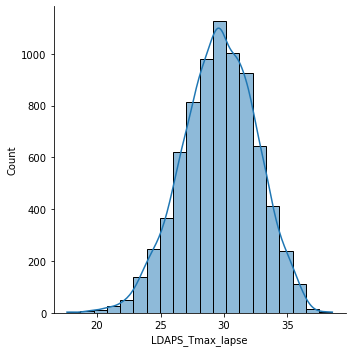

In [29]:
sns.displot(df["LDAPS_Tmax_lapse"],bins=20,kde=True)

The above distribution plot for LDAPS_Tmax_lapse

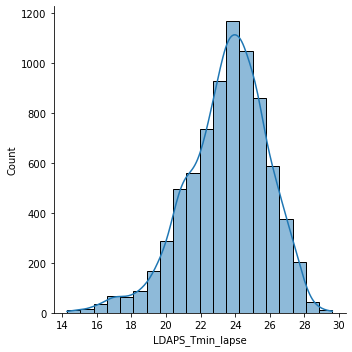

In [30]:
sns.displot(df["LDAPS_Tmin_lapse"],bins=20,kde=True)

The above distribution plot for LDAPS_Tmin_lapse

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2-D array with a single row if you intend to specify the same RGB or RGBA value for all points.


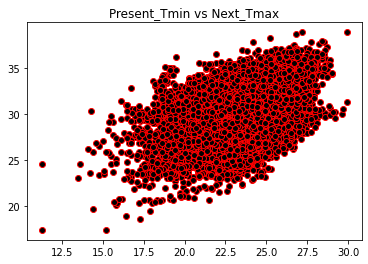

In [31]:
plt.scatter(df["Present_Tmin"],df["Next_Tmax"],alpha=1,c=(0,0,0),edgecolor="r")
plt.title("Present_Tmin vs Next_Tmax")
plt.show()

This shows the scatter plot for target variable VS column Present_Tmin.

In [32]:
colors = np.array(["red","green","blue","yellow","pink","black","orange","purple","beige","brown","gray","cyan","magenta"])

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2-D array with a single row if you intend to specify the same RGB or RGBA value for all points.


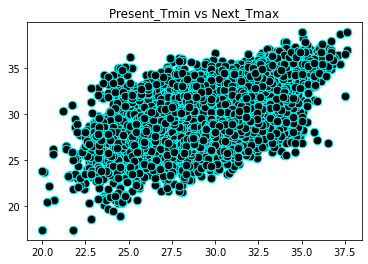

In [33]:
plt.scatter(df["Present_Tmax"],df["Next_Tmax"],c=(0,0,0),cmap='RdYlGn',edgecolor="cyan",s=75)
plt.title("Present_Tmin vs Next_Tmax")
plt.show()

This shows the scatter plot for target variable VS column Present_Tmax.

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2-D array with a single row if you intend to specify the same RGB or RGBA value for all points.


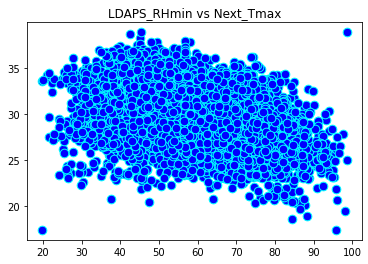

In [34]:
plt.scatter(df["LDAPS_RHmin"],df["Next_Tmax"],c=(0,0,1),cmap='RdYlGn',edgecolor="cyan",s=75)
plt.title("LDAPS_RHmin vs Next_Tmax")
plt.show()

This shows the scatter plot for target variable VS column LDAPS_RHmin.

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2-D array with a single row if you intend to specify the same RGB or RGBA value for all points.


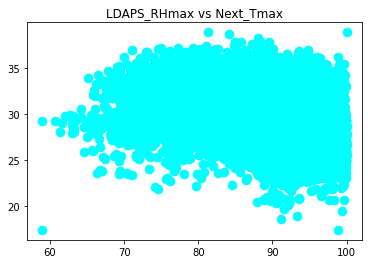

In [35]:
plt.scatter(df["LDAPS_RHmax"],df["Next_Tmax"],c=(0,1,1),cmap='RdYlGn',edgecolor="cyan",s=75)
plt.title("LDAPS_RHmax vs Next_Tmax")
plt.show()

This shows the scatter plot for target variable VS column LDAPS_RHmax.

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2-D array with a single row if you intend to specify the same RGB or RGBA value for all points.


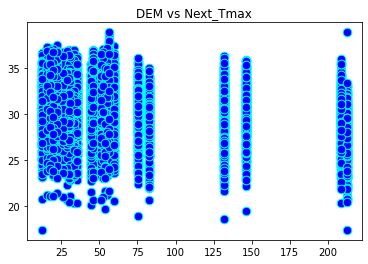

In [36]:
plt.scatter(df["DEM"],df["Next_Tmax"],c=(0,0,1),cmap='RdYlGn',edgecolor="cyan",s=75)
plt.title("DEM vs Next_Tmax")
plt.show()

This shows the scatter plot for target variable VS column DEM.

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2-D array with a single row if you intend to specify the same RGB or RGBA value for all points.


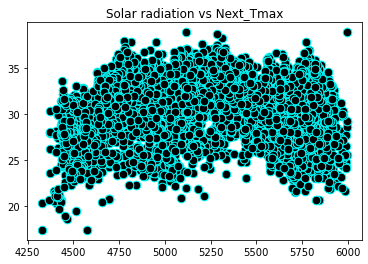

In [37]:
plt.scatter(df["Solar radiation"],df["Next_Tmax"],c=(0,0,0),cmap='RdYlGn',edgecolor="cyan",s=75)
plt.title("Solar radiation vs Next_Tmax")
plt.show()

This shows the scatter plot for target variable VS column Solar radiation.

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2-D array with a single row if you intend to specify the same RGB or RGBA value for all points.


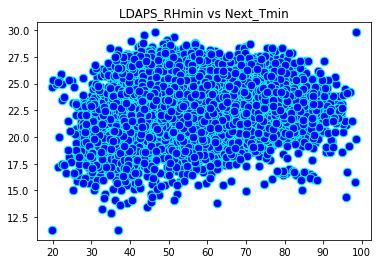

In [38]:
plt.scatter(df["LDAPS_RHmin"],df["Next_Tmin"],c=(0,0,1),cmap='RdYlGn',edgecolor="cyan",s=75)
plt.title("LDAPS_RHmin vs Next_Tmin")
plt.show()

This shows the scatter plot for target variable VS column LDAPS_RHmin.

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2-D array with a single row if you intend to specify the same RGB or RGBA value for all points.


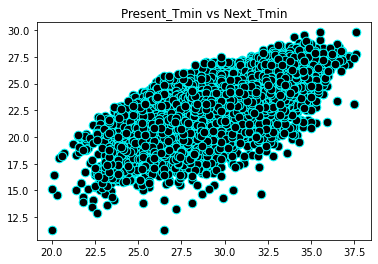

In [39]:
plt.scatter(df["Present_Tmax"],df["Next_Tmin"],c=(0,0,0),cmap='RdYlGn',edgecolor="cyan",s=75)
plt.title("Present_Tmin vs Next_Tmin")
plt.show()

This shows the scatter plot for target variable VS column Present_Tmax.

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2-D array with a single row if you intend to specify the same RGB or RGBA value for all points.


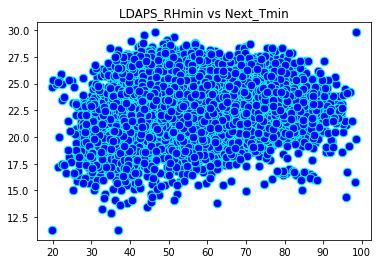

In [40]:
plt.scatter(df["LDAPS_RHmin"],df["Next_Tmin"],c=(0,0,1),cmap='RdYlGn',edgecolor="cyan",s=75)
plt.title("LDAPS_RHmin vs Next_Tmin")
plt.show()

This shows the scatter plot for target variable VS column LDAPS_RHmin.

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2-D array with a single row if you intend to specify the same RGB or RGBA value for all points.


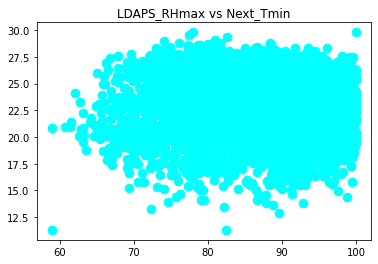

In [41]:
plt.scatter(df["LDAPS_RHmax"],df["Next_Tmin"],c=(0,1,1),cmap='RdYlGn',edgecolor="cyan",s=75)
plt.title("LDAPS_RHmax vs Next_Tmin")
plt.show()

This shows the scatter plot for target variable VS column LDAPS_RHmax.

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2-D array with a single row if you intend to specify the same RGB or RGBA value for all points.


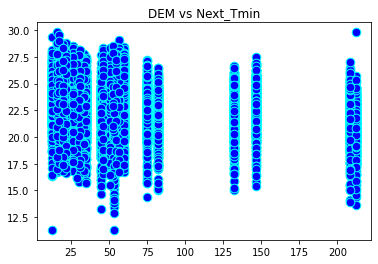

In [42]:
plt.scatter(df["DEM"],df["Next_Tmin"],c=(0,0,1),cmap='RdYlGn',edgecolor="cyan",s=75)
plt.title("DEM vs Next_Tmin")
plt.show()

This shows the scatter plot for target variable VS column DEM.

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2-D array with a single row if you intend to specify the same RGB or RGBA value for all points.


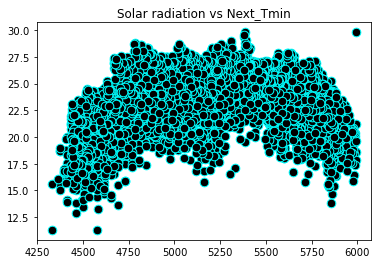

In [43]:
plt.scatter(df["Solar radiation"],df["Next_Tmin"],c=(0,0,0),cmap='RdYlGn',edgecolor="cyan",s=75)
plt.title("Solar radiation vs Next_Tmin")
plt.show()

This shows the scatter plot for target variable VS column Solar radiation.

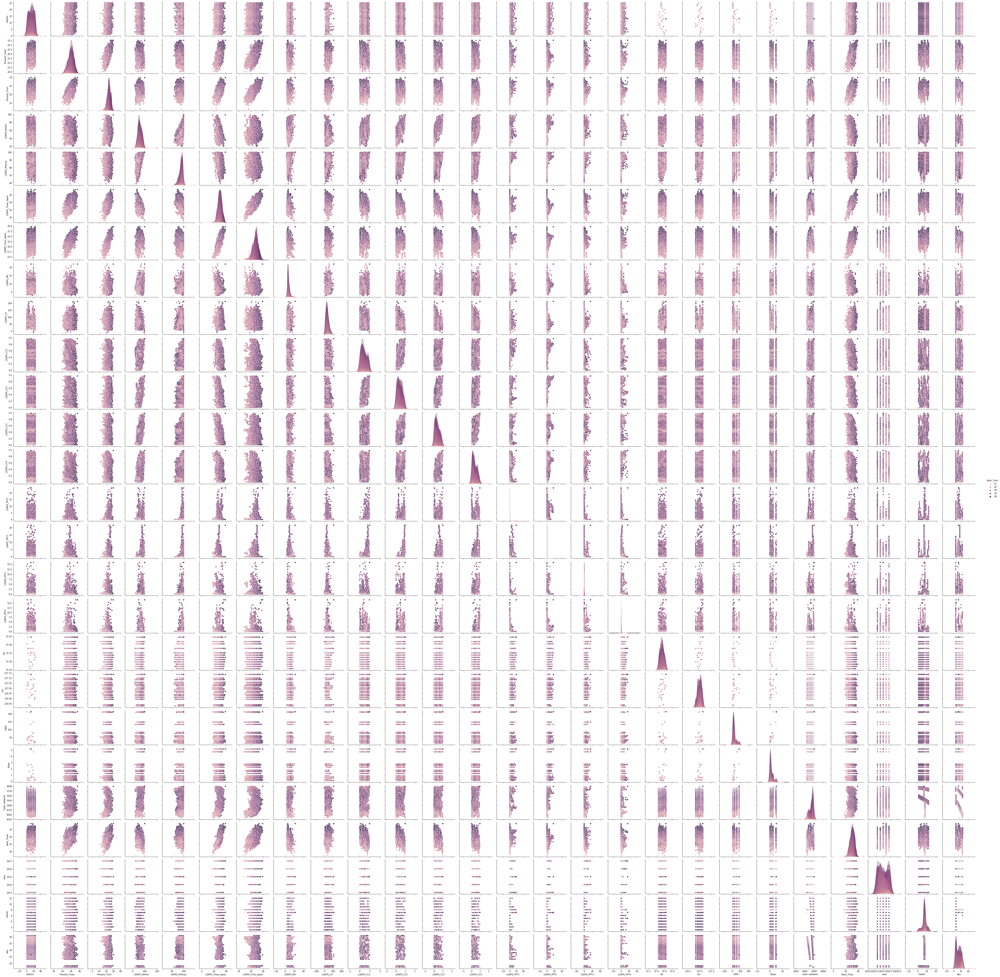

In [44]:
sns.pairplot(df,hue="Next_Tmin")

The above details show the pair plot with respect to target variable

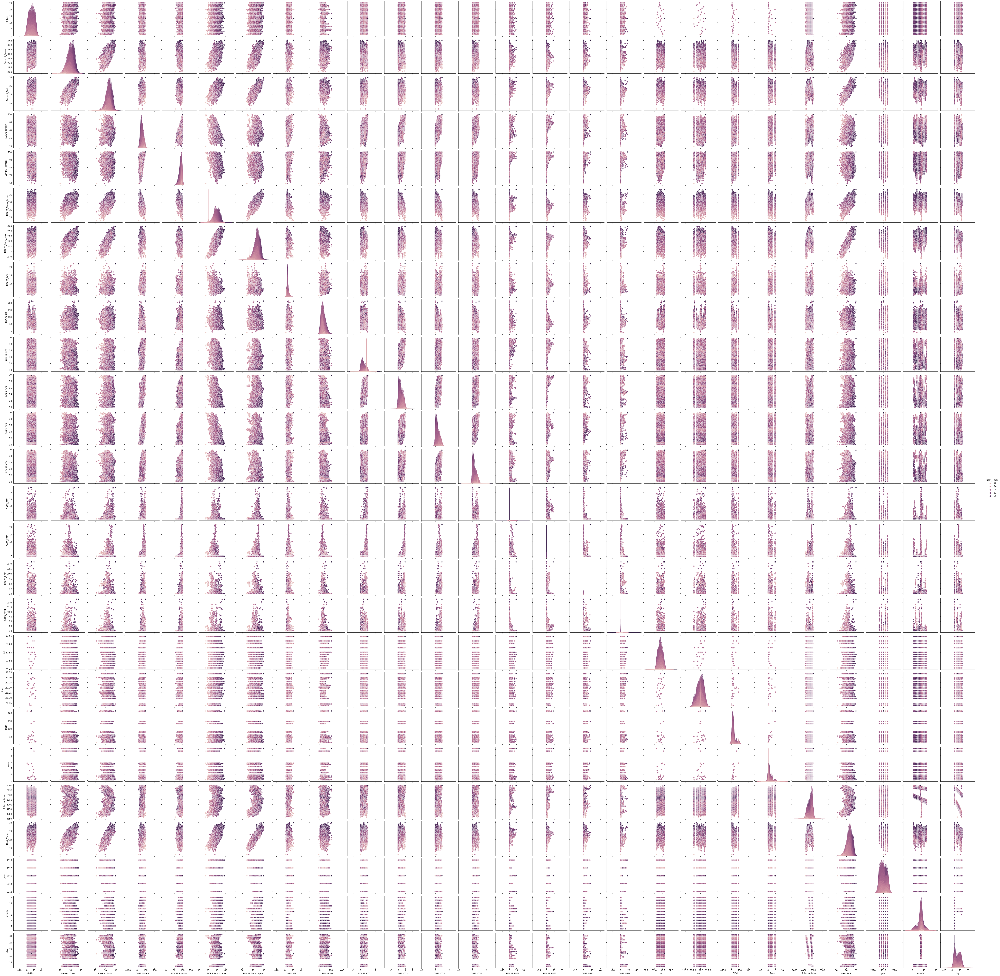

In [45]:
sns.pairplot(df,hue="Next_Tmax")

The above details show the pair plot with respect to target variable

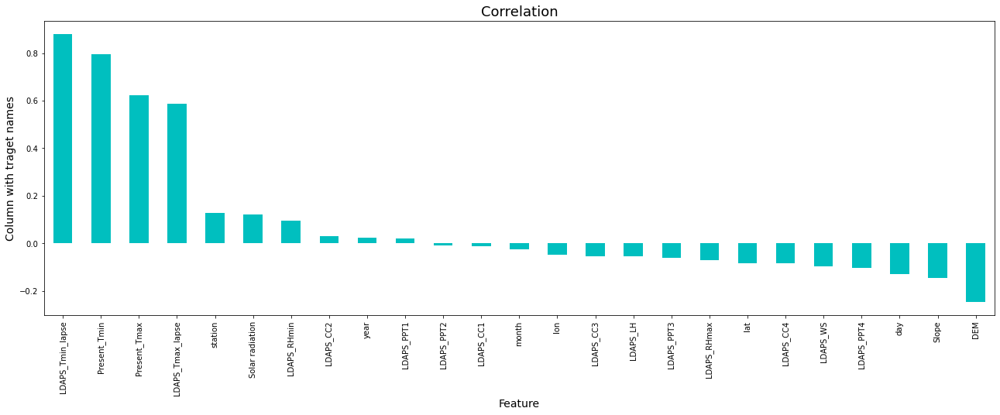

In [46]:
plt.figure(figsize=(22,7))
df.corr()["Next_Tmin"].sort_values(ascending=False).drop(["Next_Tmin","Next_Tmax"]).plot(kind="bar",color="c")
plt.xlabel("Feature",fontsize=14)
plt.ylabel("Column with traget names",fontsize=14)
plt.title("Correlation",fontsize=18)
plt.show()

Checking the columns which are positively and negatively correlated with the target variable

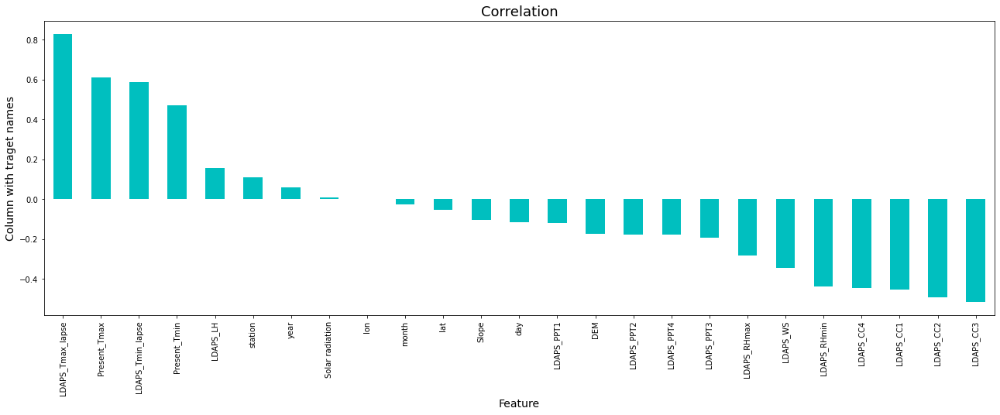

In [47]:
plt.figure(figsize=(22,7))
df.corr()["Next_Tmax"].sort_values(ascending=False).drop(["Next_Tmin","Next_Tmax"]).plot(kind="bar",color="c")
plt.xlabel("Feature",fontsize=14)
plt.ylabel("Column with traget names",fontsize=14)
plt.title("Correlation",fontsize=18)
plt.show()

Checking the columns which are positively and negatively correlated with the target variable

In [48]:
collist=df.columns.values
ncol=16
nrows=29

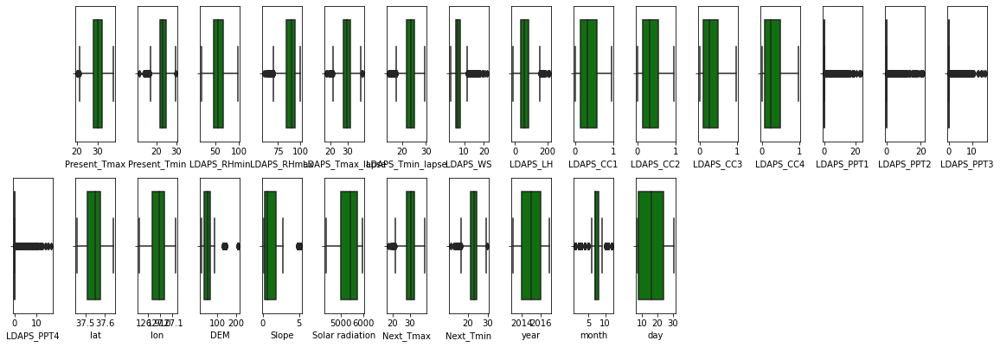

In [49]:
plt.figure(figsize=(ncol,5*ncol))
for i in range(1,len(collist)):
    plt.subplot(nrows,ncol,i+1)
    sns.boxplot(df[collist[i]],color="green",orient="v")
plt.tight_layout()

Box plot for few columns

In [50]:
df.skew()

station             0.000000
Present_Tmax       -0.264137
Present_Tmin       -0.367538
LDAPS_RHmin         0.300220
LDAPS_RHmax        -0.855015
LDAPS_Tmax_lapse   -0.227880
LDAPS_Tmin_lapse   -0.581763
LDAPS_WS            1.579236
LDAPS_LH            0.673757
LDAPS_CC1           0.459458
LDAPS_CC2           0.472350
LDAPS_CC3           0.640735
LDAPS_CC4           0.666482
LDAPS_PPT1          5.393821
LDAPS_PPT2          5.775355
LDAPS_PPT3          6.457129
LDAPS_PPT4          6.825464
lat                 0.087062
lon                -0.285213
DEM                 1.723257
Slope               1.563020
Solar radiation    -0.511210
Next_Tmax          -0.340200
Next_Tmin          -0.404447
year                0.000000
month              -0.705332
day                 0.245514
dtype: float64

As we see skewness is not in the range -0.50 and +0.50

# Zscore for removing outliers

In [51]:
from scipy.stats import zscore

zscr=np.abs(zscore(df))
threshold=3
print(np.where(zscr>3))

(array([  25,   25,   26, ..., 7751, 7751, 7751], dtype=int64), array([ 7, 14, 14, ..., 14, 15, 16], dtype=int64))


In [52]:
print("shape before removing the outliers",df.shape)
df_new1=df[(zscr<3).all(axis=1)]
print("shape after removing the outliers",df_new1.shape)

shape before removing the outliers (7752, 27)
shape after removing the outliers (6894, 27)


In [53]:
Dataloss=((7752-6894)/7752)*100
Dataloss

11.06811145510836

In [54]:
df_new1.dtypes

station             float64
Present_Tmax        float64
Present_Tmin        float64
LDAPS_RHmin         float64
LDAPS_RHmax         float64
LDAPS_Tmax_lapse    float64
LDAPS_Tmin_lapse    float64
LDAPS_WS            float64
LDAPS_LH            float64
LDAPS_CC1           float64
LDAPS_CC2           float64
LDAPS_CC3           float64
LDAPS_CC4           float64
LDAPS_PPT1          float64
LDAPS_PPT2          float64
LDAPS_PPT3          float64
LDAPS_PPT4          float64
lat                 float64
lon                 float64
DEM                 float64
Slope               float64
Solar radiation     float64
Next_Tmax           float64
Next_Tmin           float64
year                float64
month               float64
day                 float64
dtype: object

In [55]:
columns=["station","Present_Tmax","Present_Tmin","LDAPS_RHmin","LDAPS_RHmax","LDAPS_Tmax_lapse","LDAPS_Tmin_lapse","LDAPS_WS","LDAPS_LH","LDAPS_CC1","LDAPS_CC2","LDAPS_CC3","LDAPS_CC4","LDAPS_PPT1","LDAPS_PPT2","LDAPS_PPT3","LDAPS_PPT4","lat","lon","DEM","Slope","Solar radiation ","year","month","day"]

# Seperating columns into Independent variables and target variables

In [56]:
x="columns"
ymax=df_new1[["Next_Tmax"]]
ymin=df_new1[["Next_Tmin"]]

# Power transformation Method

In [57]:
from sklearn.preprocessing import power_transform
df_new2=power_transform(df_new1)

df_new2=pd.DataFrame(df_new2,columns=df_new1.columns)

In [58]:
df_new2.skew()

station            -0.201793
Present_Tmax       -0.031861
Present_Tmin       -0.021731
LDAPS_RHmin        -0.013773
LDAPS_RHmax        -0.098610
LDAPS_Tmax_lapse   -0.011202
LDAPS_Tmin_lapse   -0.025139
LDAPS_WS            0.006111
LDAPS_LH           -0.029488
LDAPS_CC1           0.062650
LDAPS_CC2           0.047088
LDAPS_CC3           0.090316
LDAPS_CC4           0.137619
LDAPS_PPT1          1.546602
LDAPS_PPT2          1.736072
LDAPS_PPT3          1.903031
LDAPS_PPT4          2.157042
lat                 0.091387
lon                -0.189409
DEM                 0.038729
Slope               0.233805
Solar radiation    -0.166145
Next_Tmax          -0.035691
Next_Tmin          -0.021823
year                0.000000
month               0.040257
day                -0.034433
dtype: float64

# Standard Scaling

In [59]:
from sklearn.preprocessing import StandardScaler
sc=StandardScaler()
x=sc.fit_transform(df_new2)
x=pd.DataFrame(x,columns=df_new2.columns)

In [60]:
x.head()

,station,Present_Tmax,Present_Tmin,LDAPS_RHmin,LDAPS_RHmax,LDAPS_Tmax_lapse,LDAPS_Tmin_lapse,LDAPS_WS,LDAPS_LH,LDAPS_CC1,LDAPS_CC2,LDAPS_CC3,LDAPS_CC4,LDAPS_PPT1,LDAPS_PPT2,LDAPS_PPT3,LDAPS_PPT4,lat,lon,DEM,Slope,Solar radiation,Next_Tmax,Next_Tmin,year,month,day
0,-1.871049,-0.480198,-0.847876,0.255239,0.347753,-0.673802,-0.357939,0.170447,0.348275,-0.315737,-0.435535,-0.471809,-0.522177,-0.538255,-0.498268,-0.475132,-0.428118,1.213124,-0.020409,1.854276,1.329510,1.889266,-0.543672,-0.823152,0.0,-0.583652,1.419544
1,-1.658471,0.668526,-0.765965,-0.177754,0.259931,-0.030722,0.111292,-0.584135,-0.171949,-0.357088,-0.201487,-0.485078,-0.542364,-0.538255,-0.498268,-0.475132,-0.428118,1.213124,0.502989,0.069427,-0.374447,1.434120,-0.073648,-0.290265,0.0,-0.583652,1.419544
2,-1.464383,0.555342,-0.045094,-0.448722,-0.726467,0.057585,0.364952,-0.260420,-1.388942,-0.437895,-0.174674,-0.233244,-0.452799,-0.538255,-0.498268,-0.475132,-0.428118,0.676888,0.841275,-0.353718,-0.943391,1.413770,0.135006,0.312510,0.0,-0.583652,1.419544
3,-1.282978,0.706507,-0.001324,0.254123,1.383197,-0.084189,-0.215346,-0.616421,0.243476,-0.402497,-0.325470,-0.474980,-0.501403,-0.538255,-0.498268,-0.475132,-0.428118,2.009191,0.374205,0.098490,1.250934,1.390562,0.348002,0.490201,0.0,-0.583652,1.419544
4,-1.111079,0.480519,-0.641952,0.107664,0.184230,-0.299338,-0.142691,-0.551233,1.303975,-0.746080,-0.209888,-0.372540,-0.287950,-0.538255,-0.498268,-0.475132,-0.428118,0.140652,1.872937,-0.279099,-0.390970,1.399661,0.170204,-0.290265,0.0,-0.583652,1.419544


# Train test split

In [61]:
x_train,x_test,ymax_train,ymax_test=train_test_split(x,ymax,test_size=0.22,random_state=43)
print(x_train.shape)
print(x_test.shape)
print(ymax_train.shape)
print(ymax_test.shape)

(5377, 27)
(1517, 27)
(5377, 1)
(1517, 1)


# Linear Regression

In [62]:
from sklearn.linear_model import LinearRegression
lr=LinearRegression()
from sklearn.metrics import r2_score

In [63]:
lr.fit(x_train,ymax_train)

LinearRegression()

In [64]:
lr.coef_

array([[ 4.68375742e-05, -7.03866650e-03, -4.86018778e-03,
         1.08995902e-02,  1.86630018e-02,  1.17227917e-02,
        -1.47317483e-03,  7.07235845e-03, -9.08248195e-03,
        -2.45445874e-02,  2.73630489e-02,  2.17569123e-02,
        -2.50494373e-02, -2.61439776e-02, -1.70295315e-02,
        -1.82308635e-02, -1.94559398e-02, -4.90605529e-03,
         3.90281001e-03, -1.27830595e-02,  1.55371678e-03,
         1.95192071e-02,  2.93811431e+00, -2.20397984e-02,
        -5.82867088e-16, -7.14359003e-03,  2.90042682e-02]])

In [65]:
lr.intercept_

array([30.5653443])

In [66]:
lr.score(x_train,ymax_train)

0.9964845833074828

In [67]:
for i in range(0,100):
    lr.fit(x_train,ymax_train)
    pred_train=lr.predict(x_train)
    pred_test=lr.predict(x_test)
    print(f"At random state{i},the training accuracy is :- {r2_score(ymax_train,pred_train)}")
    print(f"At random state{i},the testing accuracy is :- {r2_score(ymax_test,pred_test)}")
    print("\n")

At random state0,the training accuracy is :- 0.9964845833074828
At random state0,the testing accuracy is :- 0.9964531624583751


At random state1,the training accuracy is :- 0.9964845833074828
At random state1,the testing accuracy is :- 0.9964531624583751


At random state2,the training accuracy is :- 0.9964845833074828
At random state2,the testing accuracy is :- 0.9964531624583751


At random state3,the training accuracy is :- 0.9964845833074828
At random state3,the testing accuracy is :- 0.9964531624583751


At random state4,the training accuracy is :- 0.9964845833074828
At random state4,the testing accuracy is :- 0.9964531624583751


At random state5,the training accuracy is :- 0.9964845833074828
At random state5,the testing accuracy is :- 0.9964531624583751


At random state6,the training accuracy is :- 0.9964845833074828
At random state6,the testing accuracy is :- 0.9964531624583751


At random state7,the training accuracy is :- 0.9964845833074828
At random state7,the testing accu

In [68]:
pred=lr.predict(x_test)
print("Predicted result : ",pred)
print("actual result",ymax_test)

Predicted result :  [[33.30123108]
 [35.03803968]
 [25.76678004]
 ...
 [35.92986938]
 [33.23383257]
 [30.68609455]]
actual result       Next_Tmax
6344       33.3
4903       34.9
189        25.5
6447       26.1
3838       33.4
...         ...
2202       29.6
3171       27.1
4022       35.6
5442       33.4
1437       30.8

[1517 rows x 1 columns]


# DecisionTreeRegressor

In [69]:
from sklearn.tree import DecisionTreeRegressor
dtr=DecisionTreeRegressor()
dtr.fit(x_train,ymax_train)
preddtr=dtr.predict(x_test)
preddtr
dtr.score(x_train,ymax_train)

1.0

# Support Vector Regressor

In [70]:
from sklearn.svm import SVR
sv=SVR()
sv.fit(x_train,ymax_train)
predsv=dtr.predict(x_test)
predsv
sv.score(x_train,ymax_train)

0.9969201529388928

# MSE,MBE and RMBE

In [71]:
print("error:")
print("Mean absolute error : ",mean_absolute_error(ymax_test,pred))
print("Mean square error : ",mean_squared_error(ymax_test,pred))
print(" Root Mean absolute error : ",np.sqrt(mean_squared_error(ymax_test,pred)))

error:
Mean absolute error :  0.1264893908685924
Mean square error :  0.03115596034344646
 Root Mean absolute error :  0.17651051057499795


In [72]:
print(r2_score(ymax_test,pred))

0.9964531624583751


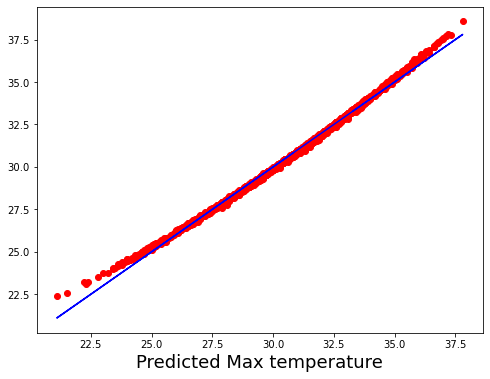

In [73]:
plt.figure(figsize=(8,6))
plt.scatter(x=ymax_test,y=pred_test,color="r")
plt.plot(ymax_test,ymax_test,color="b")
plt.xlabel("Predicted Max temperature",fontsize=18)
plt.show()

The above scatter plot shows Predicted Max Temperature

# Regularization with Lasoo and Ridge Regressor

In [74]:
from sklearn.model_selection import GridSearchCV
from sklearn.linear_model import Lasso
from sklearn.linear_model import Ridge

In [75]:
parameters={"alpha":[.0001,.001,.01,.1,1,10],"random_state":list(range(0,10))}
ls=Lasso()
clf=GridSearchCV(ls,parameters)
clf.fit(x_train,ymax_train)

print(clf.best_params_)

{'alpha': 0.0001, 'random_state': 0}


In [76]:
ls=Lasso(alpha=.0001,random_state=0)
ls.fit(x_train,ymax_train)
ls.score(x_train,ymax_train)
pred_ls=ls.predict(x_test)

lss=r2_score(ymax_test,pred_ls)
lss

0.9964548940116742

In [77]:
from sklearn.model_selection import cross_val_score
cv_score=cross_val_score(ls,x,ymax,cv=5)
cv_mean=cv_score.mean()
cv_mean

0.9955598359934494

In [78]:
parameters={"alpha":[.0001,.001,.01,.1,1,10],"random_state":list(range(0,10))}
rd=Ridge()
clf=GridSearchCV(rd,parameters)
clf.fit(x_train,ymax_train)

print(clf.best_params_)

{'alpha': 0.1, 'random_state': 0}


In [79]:
rd=Ridge(alpha=1,random_state=0)
rd.fit(x_train,ymax_train)
rd.score(x_train,ymax_train)
pred_rd=rd.predict(x_test)

rdr=r2_score(ymax_test,pred_rd)
rdr

0.9964546309611354

In [80]:
cv_score=cross_val_score(rd,x,ymax,cv=5)
cv_mean=cv_score.mean()
cv_mean

0.9955550850621607

# Ensemble Methods using Random forest and Ada booster

In [81]:
from sklearn.ensemble import RandomForestRegressor

In [82]:
parameters={"criterion":["mse","mae"],"max_features":["auto","sqrt","log2"]}
rf=RandomForestRegressor()
clf=GridSearchCV(rf,parameters)
clf.fit(x_train,ymax_train)
print(clf.best_params_)

{'criterion': 'mse', 'max_features': 'auto'}


In [83]:
    rf=RandomForestRegressor(criterion="mse",max_features="auto")
    rf.fit(x_train,ymax_train)
    rf.score(x_train,ymax_train)
    pred_rf=rf.predict(x_test)

    rfs=r2_score(ymax_test,pred_rf)
    print("R2 score : ",rfs*100)

    rfscore=cross_val_score(rf,x,ymax,cv=5)
    rfc=rfscore.mean()
    print("Cross Val Score : ",rfs*100)

R2 score :  99.99475749560666
Cross Val Score :  99.99475749560666


In [84]:
from sklearn.ensemble import AdaBoostRegressor

In [85]:
ad=AdaBoostRegressor(n_estimators=100)
ad.fit(x_train,ymax_train)
ad.score(x_train,ymax_train)
pred_ad=ad.predict(x_test)

ads=r2_score(ymax_test,pred_ad)
print("R2 score : ",ads*100)

adscore=cross_val_score(ad,x,ymax,cv=5)
adc=adscore.mean()
print("Cross Val Score : ",ads*100)

R2 score :  99.53435704755114
Cross Val Score :  99.53435704755114


# Cross validation Method

In [86]:
score=cross_val_score(sv,x,ymax,cv=5)
print(score)
print(score.mean())

[0.98409478 0.94835434 0.98026206 0.97517643 0.97732548]
0.9730426170143375


In [87]:
score=cross_val_score(dtr,x,ymax,cv=5)
print(score)
print(score.mean())

[0.9999936  0.99997241 0.99997868 0.99923795 0.99999755]
0.9998360388477214


# Train test split

In [88]:
x_train,x_test,ymin_train,ymin_test=train_test_split(x,ymin,test_size=0.22,random_state=43)
print(x_train.shape)
print(x_test.shape)
print(ymin_train.shape)
print(ymin_test.shape)

(5377, 27)
(1517, 27)
(5377, 1)
(1517, 1)


# Linear Regression

In [89]:
lr.fit(x_train,ymin_train)

LinearRegression()

In [90]:
lr.score(x_train,ymin_train)

0.9973312872605973

In [91]:
for i in range(0,100):
    lr.fit(x_train,ymin_train)
    pred_train=lr.predict(x_train)
    pred_test=lr.predict(x_test)
    print(f"At random state{i},the training accuracy is :- {r2_score(ymin_train,pred_train)}")
    print(f"At random state{i},the testing accuracy is :- {r2_score(ymin_test,pred_test)}")
    print("\n")

At random state0,the training accuracy is :- 0.9973312872605973
At random state0,the testing accuracy is :- 0.9971920601932012


At random state1,the training accuracy is :- 0.9973312872605973
At random state1,the testing accuracy is :- 0.9971920601932012


At random state2,the training accuracy is :- 0.9973312872605973
At random state2,the testing accuracy is :- 0.9971920601932012


At random state3,the training accuracy is :- 0.9973312872605973
At random state3,the testing accuracy is :- 0.9971920601932012


At random state4,the training accuracy is :- 0.9973312872605973
At random state4,the testing accuracy is :- 0.9971920601932012


At random state5,the training accuracy is :- 0.9973312872605973
At random state5,the testing accuracy is :- 0.9971920601932012


At random state6,the training accuracy is :- 0.9973312872605973
At random state6,the testing accuracy is :- 0.9971920601932012


At random state7,the training accuracy is :- 0.9973312872605973
At random state7,the testing accu

# DecisionTreeRegressor

In [92]:
dtr=DecisionTreeRegressor()
dtr.fit(x_train,ymin_train)
preddtr=dtr.predict(x_test)
preddtr
dtr.score(x_train,ymin_train)

1.0

# Support Vector Regressor

In [93]:
sv=SVR()
sv.fit(x_train,ymin_train)
predsv=dtr.predict(x_test)
predsv
sv.score(x_train,ymin_train)

0.9971606273793049

# MSE,MBE and RMBE

In [94]:
print("error:")
print("Mean absolute error : ",mean_absolute_error(ymin_test,pred))
print("Mean square error : ",mean_squared_error(ymin_test,pred))
print(" Root Mean absolute error : ",np.sqrt(mean_squared_error(ymin_test,pred)))

error:
Mean absolute error :  7.574552046748749
Mean square error :  63.766954728618614
 Root Mean absolute error :  7.985421387041426


In [95]:
print(r2_score(ymin_test,pred))

-10.63899431928029


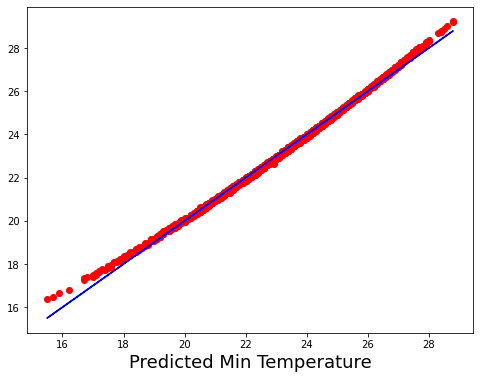

In [96]:
plt.figure(figsize=(8,6))
plt.scatter(x=ymin_test,y=pred_test,color="r")
plt.plot(ymin_test,ymin_test,color="b")
plt.xlabel("Predicted Min Temperature",fontsize=18)
plt.show()

The above scatter plot shows Predicted Min Temperature

# Regularization with Lasoo and Ridge Regressor

In [97]:
parameters={"alpha":[.0001,.001,.01,.1,1,10],"random_state":list(range(0,10))}
ls=Lasso()
clf=GridSearchCV(ls,parameters)
clf.fit(x_train,ymin_train)

print(clf.best_params_)

{'alpha': 0.0001, 'random_state': 0}


In [98]:
ls=Lasso(alpha=.0001,random_state=0)
ls.fit(x_train,ymin_train)
ls.score(x_train,ymin_train)
pred_ls=ls.predict(x_test)

lss=r2_score(ymin_test,pred_ls)
lss

0.9971915055297614

In [99]:
cv_score=cross_val_score(ls,x,ymin,cv=5)
cv_mean=cv_score.mean()
cv_mean

0.996286270766034

In [100]:
parameters={"alpha":[.0001,.001,.01,.1,1,10],"random_state":list(range(0,10))}
rd=Ridge()
clf=GridSearchCV(rd,parameters)
clf.fit(x_train,ymin_train)

print(clf.best_params_)

{'alpha': 0.0001, 'random_state': 0}


In [101]:
rd=Ridge(alpha=0.0001,random_state=0)
rd.fit(x_train,ymin_train)
rd.score(x_train,ymin_train)
pred_rd=rd.predict(x_test)

rdr=r2_score(ymin_test,pred_rd)
rdr

0.997192060296876

In [102]:
cv_score=cross_val_score(rd,x,ymin,cv=5)
cv_mean=cv_score.mean()
cv_mean

0.9962801472401426

# Ensemble Methods using Random forest and Ada booster

In [103]:
parameters={"criterion":["mse","mae"],"max_features":["auto","sqrt","log2"]}
rf=RandomForestRegressor()
clf=GridSearchCV(rf,parameters)
clf.fit(x_train,ymin_train)
print(clf.best_params_)

{'criterion': 'mae', 'max_features': 'auto'}


In [104]:
    rf=RandomForestRegressor(criterion="mse",max_features="auto")
    rf.fit(x_train,ymin_train)
    rf.score(x_train,ymin_train)
    pred_rf=rf.predict(x_test)

    rfs=r2_score(ymin_test,pred_rf)
    print("R2 score : ",rfs*100)

    rfscore=cross_val_score(rf,x,ymin,cv=5)
    rfc=rfscore.mean()
    print("Cross Val Score : ",rfs*100)

R2 score :  99.99957204939608
Cross Val Score :  99.99957204939608


In [105]:
ad=AdaBoostRegressor(n_estimators=100)
ad.fit(x_train,ymin_train)
ad.score(x_train,ymin_train)
pred_ad=ad.predict(x_test)

ads=r2_score(ymin_test,pred_ad)
print("R2 score : ",ads*100)

adscore=cross_val_score(ad,x,ymin,cv=5)
adc=adscore.mean()
print("Cross Val Score : ",ads*100)

R2 score :  99.56004646634028
Cross Val Score :  99.56004646634028


# Cross Validation method

In [106]:
score=cross_val_score(sv,x,ymin,cv=5)
print(score)
print(score.mean())

[0.98882633 0.95623237 0.98222    0.97225088 0.98233369]
0.9763726544919292


In [107]:
score=cross_val_score(dtr,x,ymin,cv=5)
print(score)
print(score.mean())

[1.         0.99974333 0.99998211 0.9999784  0.99985836]
0.9999124393273598


# Saving the best model accuracy

In [108]:
import pickle
filename="Max Temperature.pkl"
pickle.dump(dtr,open(filename,"wb"))

In [109]:
import pickle
filename="Min Temperature.pkl"
pickle.dump(dtr,open(filename,"wb"))

# Conclusion

In [ ]:
loaded_model=pickle.load(open("Max Temperature.pkl","rb"))
result=loaded_model.score(x_test,ymax_test)
print(result)    

In [111]:
loaded_model=pickle.load(open("Min Temperature.pkl","rb"))
result=loaded_model.score(x_test,ymin_test)
print(result)    

0.9999855617205154


In [112]:
conclusion=pd.DataFrame([loaded_model.predict(x_test)[:]],index=["Predicted","Original"])
conclusion

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,115,116,117,118,119,120,121,122,123,124,125,126,127,128,129,130,131,132,133,134,135,136,137,138,139,140,141,142,143,144,145,146,147,148,149,150,151,152,153,154,155,156,157,158,159,160,161,162,163,164,165,166,167,168,169,170,171,172,173,174,175,176,177,178,179,180,181,182,183,184,185,186,187,188,189,190,191,192,193,194,195,196,197,198,199,200,201,202,203,204,205,206,207,208,209,210,211,212,213,214,215,216,217,218,219,220,221,222,223,224,225,226,227,228,229,230,231,232,233,234,235,236,237,238,239,240,241,242,243,244,245,246,247,248,249,250,251,252,253,254,255,256,257,258,259,260,261,262,263,264,265,266,267,268,269,270,271,272,273,274,275,276,277,278,279,280,281,282,283,284,285,286,287,288,289,290,291,292,293,294,295,296,297,298,299,300,301,302,303,304,305,306,307,308,309,310,311,312,313,314,315,316,317,318,319,320,321,322,323,324,325,326,327,328,329,330,331,332,333,334,335,336,337,338,339,340,341,342,343,344,345,346,347,348,349,350,351,352,353,354,355,356,357,358,359,360,361,362,363,364,365,366,367,368,369,370,371,372,373,374,375,376,377,378,379,380,381,382,383,384,385,386,387,388,389,390,391,392,393,394,395,396,397,398,399,400,401,402,403,404,405,406,407,408,409,410,411,412,413,414,415,416,417,418,419,420,421,422,423,424,425,426,427,428,429,430,431,432,433,434,435,436,437,438,439,440,441,442,443,444,445,446,447,448,449,450,451,452,453,454,455,456,457,458,459,460,461,462,463,464,465,466,467,468,469,470,471,472,473,474,475,476,477,478,479,480,481,482,483,484,485,486,487,488,489,490,491,492,493,494,495,496,497,498,499,500,501,502,503,504,505,506,507,508,509,510,511,512,513,514,515,516,517,518,519,520,521,522,523,524,525,526,527,528,529,530,531,532,533,534,535,536,537,538,539,540,541,542,543,544,545,546,547,548,549,550,551,552,553,554,555,556,557,558,559,560,561,562,563,564,565,566,567,568,569,570,571,572,573,574,575,576,577,578,579,580,581,582,583,584,585,586,587,588,589,590,591,592,593,594,595,596,597,598,599,600,601,602,603,604,605,606,607,608,609,610,611,612,613,614,615,616,617,618,619,620,621,622,623,624,625,626,627,628,629,630,631,632,633,634,635,636,637,638,639,640,641,642,643,644,645,646,647,648,649,650,651,652,653,654,655,656,657,658,659,660,661,662,663,664,665,666,667,668,669,670,671,672,673,674,675,676,677,678,679,680,681,682,683,684,685,686,687,688,689,690,691,692,693,694,695,696,697,698,699,700,701,702,703,704,705,706,707,708,709,710,711,712,713,714,715,716,717,718,719,720,721,722,723,724,725,726,727,728,729,730,731,732,733,734,735,736,737,738,739,740,741,742,743,744,745,746,747,748,749,750,751,752,753,754,755,756,757,758,759,760,761,762,763,764,765,766,767,768,769,770,771,772,773,774,775,776,777,778,779,780,781,782,783,784,785,786,787,788,789,790,791,792,793,794,795,796,797,798,799,800,801,802,803,804,805,806,807,808,809,810,811,812,813,814,815,816,817,818,819,820,821,822,823,824,825,826,827,828,829,830,831,832,833,834,835,836,837,838,839,840,841,842,843,844,845,846,847,848,849,850,851,852,853,854,855,856,857,858,859,860,861,862,863,864,865,866,867,868,869,870,871,872,873,874,875,876,877,878,879,880,881,882,883,884,885,886,887,888,889,890,891,892,893,894,895,896,897,898,899,900,901,902,903,904,905,906,907,908,909,910,911,912,913,914,915,916,917,918,919,920,921,922,923,924,925,926,927,928,929,930,931,932,933,934,935,936,937,938,939,940,941,942,943,944,945,946,947,948,949,950,951,952,953,954,955,956,957,958,959,960,961,962,963,964,965,966,967,968,969,970,971,972,973,974,975,976,977,978,979,980,981,982,983,984,985,986,987,988,989,990,991,992,993,994,995,996,997,998,999,1000,1001,1002,1003,1004,1005,1006,1007,1008,1009,1010,1011,1012,1013,1014,1015,1016,1017,1018,1019,1020,1021